# 07. PyTorch Experiment Tracking Exercise Template

Welcome to the 07. PyTorch Experiment Tracking exercise template notebook.

> **Note:** There may be more than one solution to each of the exercises. This notebook only shows one possible example.

## Resources

1. These exercises/solutions are based on [section 07. PyTorch Transfer Learning](https://www.learnpytorch.io/07_pytorch_experiment_tracking/) of the Learn PyTorch for Deep Learning course by Zero to Mastery.
2. See a live [walkthrough of the solutions (errors and all) on YouTube](https://youtu.be/cO_r2FYcAjU).
3. See [other solutions on the course GitHub](https://github.com/mrdbourke/pytorch-deep-learning/tree/main/extras/solutions).

> **Note:** The first section of this notebook is dedicated to getting various helper functions and datasets used for the exercises. The exercises start at the heading "Exercise 1: ...".

### Get various imports and helper functions

We'll need to make sure we have `torch` v.1.12+ and `torchvision` v0.13+.

In [ ]:
import torch
import torchvision

In [ ]:
 # Make sure we have a GPU
 device = "cuda" if torch.cuda.is_available() else "cpu"
 device

'cuda'

In [ ]:
# Get regular imports
import matplotlib.pyplot as plt
import torch
import torchvision

from torch import nn
from torchvision import transforms

# Try to get torchinfo, install it if it doesn't work
try:
    from torchinfo import summary
except:
    print("[INFO] Couldn't find torchinfo... installing it.")
    !pip install -q torchinfo
    from torchinfo import summary

# Try to import the going_modular directory, download it from GitHub if it doesn't work
try:
    from going_modular.going_modular import data_setup, engine
except:
    # Get the going_modular scripts
    print("[INFO] Couldn't find going_modular scripts... downloading them from GitHub.")
    !git clone https://github.com/mrdbourke/pytorch-deep-learning
    !mv pytorch-deep-learning/going_modular .
    !rm -rf pytorch-deep-learning
    from going_modular.going_modular import data_setup, engine

In [ ]:
# Set seeds
def set_seeds(seed: int=42):
    """Sets random sets for torch operations.

    Args:
        seed (int, optional): Random seed to set. Defaults to 42.
    """
    # Set the seed for general torch operations
    torch.manual_seed(seed)
    # Set the seed for CUDA torch operations (ones that happen on the GPU)
    torch.cuda.manual_seed(seed)

In [ ]:
import os
import zipfile

from pathlib import Path

import requests

def download_data(source: str,
                  destination: str,
                  remove_source: bool = True) -> Path:
    """Downloads a zipped dataset from source and unzips to destination.

    Args:
        source (str): A link to a zipped file containing data.
        destination (str): A target directory to unzip data to.
        remove_source (bool): Whether to remove the source after downloading and extracting.

    Returns:
        pathlib.Path to downloaded data.

    Example usage:
        download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                      destination="pizza_steak_sushi")
    """
    # Setup path to data folder
    data_path = Path("data/")
    image_path = data_path / destination

    # If the image folder doesn't exist, download it and prepare it...
    if image_path.is_dir():
        print(f"[INFO] {image_path} directory exists, skipping download.")
    else:
        print(f"[INFO] Did not find {image_path} directory, creating one...")
        image_path.mkdir(parents=True, exist_ok=True)

        # Download pizza, steak, sushi data
        target_file = Path(source).name
        with open(data_path / target_file, "wb") as f:
            request = requests.get(source)
            print(f"[INFO] Downloading {target_file} from {source}...")
            f.write(request.content)

        # Unzip pizza, steak, sushi data
        with zipfile.ZipFile(data_path / target_file, "r") as zip_ref:
            print(f"[INFO] Unzipping {target_file} data...")
            zip_ref.extractall(image_path)

        # Remove .zip file
        if remove_source:
            os.remove(data_path / target_file)

    return image_path

image_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                           destination="pizza_steak_sushi")
image_path

[INFO] data/pizza_steak_sushi directory exists, skipping download.


PosixPath('data/pizza_steak_sushi')

In [ ]:
from torch.utils.tensorboard import SummaryWriter
def create_writer(experiment_name: str,
                  model_name: str,
                  extra: str=None):
    """Creates a torch.utils.tensorboard.writer.SummaryWriter() instance saving to a specific log_dir.

    log_dir is a combination of runs/timestamp/experiment_name/model_name/extra.

    Where timestamp is the current date in YYYY-MM-DD format.

    Args:
        experiment_name (str): Name of experiment.
        model_name (str): Name of model.
        extra (str, optional): Anything extra to add to the directory. Defaults to None.

    Returns:
        torch.utils.tensorboard.writer.SummaryWriter(): Instance of a writer saving to log_dir.

    Example usage:
        # Create a writer saving to "runs/2022-06-04/data_10_percent/effnetb2/5_epochs/"
        writer = create_writer(experiment_name="data_10_percent",
                               model_name="effnetb2",
                               extra="5_epochs")
        # The above is the same as:
        writer = SummaryWriter(log_dir="runs/2022-06-04/data_10_percent/effnetb2/5_epochs/")
    """
    from datetime import datetime
    import os

    # Get timestamp of current date (all experiments on certain day live in same folder)
    timestamp = datetime.now().strftime("%Y-%m-%d") # returns current date in YYYY-MM-DD format

    if extra:
        # Create log directory path
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
    else:
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name)

    print(f"[INFO] Created SummaryWriter, saving to: {log_dir}...")
    return SummaryWriter(log_dir=log_dir)

In [ ]:
# Create a test writer
writer = create_writer(experiment_name="test_experiment_name",
                       model_name="this_is_the_model_name",
                       extra="add_a_little_extra_if_you_want")

[INFO] Created SummaryWriter, saving to: runs/2024-06-10/test_experiment_name/this_is_the_model_name/add_a_little_extra_if_you_want...


In [ ]:
from typing import Dict, List
from tqdm.auto import tqdm

from going_modular.going_modular.engine import train_step, test_step

# Add writer parameter to train()
def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter # new parameter to take in a writer
          ) -> Dict[str, List]:
    """Trains and tests a PyTorch model.

    Passes a target PyTorch models through train_step() and test_step()
    functions for a number of epochs, training and testing the model
    in the same epoch loop.

    Calculates, prints and stores evaluation metrics throughout.

    Stores metrics to specified writer log_dir if present.

    Args:
      model: A PyTorch model to be trained and tested.
      train_dataloader: A DataLoader instance for the model to be trained on.
      test_dataloader: A DataLoader instance for the model to be tested on.
      optimizer: A PyTorch optimizer to help minimize the loss function.
      loss_fn: A PyTorch loss function to calculate loss on both datasets.
      epochs: An integer indicating how many epochs to train for.
      device: A target device to compute on (e.g. "cuda" or "cpu").
      writer: A SummaryWriter() instance to log model results to.

    Returns:
      A dictionary of training and testing loss as well as training and
      testing accuracy metrics. Each metric has a value in a list for
      each epoch.
      In the form: {train_loss: [...],
                train_acc: [...],
                test_loss: [...],
                test_acc: [...]}
      For example if training for epochs=2:
              {train_loss: [2.0616, 1.0537],
                train_acc: [0.3945, 0.3945],
                test_loss: [1.2641, 1.5706],
                test_acc: [0.3400, 0.2973]}
    """
    # Create empty results dictionary
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []
    }

    # Loop through training and testing steps for a number of epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                          dataloader=train_dataloader,
                                          loss_fn=loss_fn,
                                          optimizer=optimizer,
                                          device=device)
        test_loss, test_acc = test_step(model=model,
          dataloader=test_dataloader,
          loss_fn=loss_fn,
          device=device)

        # Print out what's happening
        print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
        )

        # Update results dictionary
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)


        ### New: Use the writer parameter to track experiments ###
        # See if there's a writer, if so, log to it
        if writer:
            # Add results to SummaryWriter
            writer.add_scalars(main_tag="Loss",
                               tag_scalar_dict={"train_loss": train_loss,
                                                "test_loss": test_loss},
                               global_step=epoch)
            writer.add_scalars(main_tag="Accuracy",
                               tag_scalar_dict={"train_acc": train_acc,
                                                "test_acc": test_acc},
                               global_step=epoch)

            # Close the writer
            writer.close()
        else:
            pass
    ### End new ###

    # Return the filled results at the end of the epochs
    return results

### Download data

Using the same data from https://www.learnpytorch.io/07_pytorch_experiment_tracking/

In [ ]:
# Download 10 percent and 20 percent training data (if necessary)
data_10_percent_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                                     destination="pizza_steak_sushi")

data_20_percent_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi_20_percent.zip",
                                     destination="pizza_steak_sushi_20_percent")

[INFO] data/pizza_steak_sushi directory exists, skipping download.
[INFO] Did not find data/pizza_steak_sushi_20_percent directory, creating one...
[INFO] Downloading pizza_steak_sushi_20_percent.zip from https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi_20_percent.zip...
[INFO] Unzipping pizza_steak_sushi_20_percent.zip data...


In [ ]:
# Setup training directory paths
train_dir_10_percent = data_10_percent_path / "train"
train_dir_20_percent = data_20_percent_path / "train"

# Setup testing directory paths (note: use the same test dataset for both to compare the results)
test_dir = data_10_percent_path / "test"

# Check the directories
print(f"Training directory 10%: {train_dir_10_percent}")
print(f"Training directory 20%: {train_dir_20_percent}")
print(f"Testing directory: {test_dir}")

Training directory 10%: data/pizza_steak_sushi/train
Training directory 20%: data/pizza_steak_sushi_20_percent/train
Testing directory: data/pizza_steak_sushi/test


In [ ]:
from torchvision import transforms

# Create a transform to normalize data distribution to be inline with ImageNet
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], # values per colour channel [red, green, blue]
                                 std=[0.229, 0.224, 0.225])

# Create a transform pipeline
simple_transform = transforms.Compose([
                                       transforms.Resize((224, 224)),
                                       transforms.ToTensor(), # get image values between 0 & 1
                                       normalize
])

### Turn data into DataLoaders

In [ ]:
BATCH_SIZE = 32

# Create 10% training and test DataLoaders
train_dataloader_10_percent, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_10_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=simple_transform,
                                                                                          batch_size=BATCH_SIZE)

# Create 20% training and test DataLoaders
train_dataloader_20_percent, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_20_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=simple_transform,
                                                                                          batch_size=BATCH_SIZE)

# Find the number of samples/batches per dataloader (using the same test_dataloader for both experiments)
print(f"Number of batches of size {BATCH_SIZE} in 10 percent training data: {len(train_dataloader_10_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in 20 percent training data: {len(train_dataloader_20_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in testing data: {len(test_dataloader)} (all experiments will use the same test set)")
print(f"Number of classes: {len(class_names)}, class names: {class_names}")

Number of batches of size 32 in 10 percent training data: 8
Number of batches of size 32 in 20 percent training data: 15
Number of batches of size 32 in testing data: 8 (all experiments will use the same test set)
Number of classes: 3, class names: ['pizza', 'steak', 'sushi']


## Exercise 1: Pick a larger model from [`torchvision.models`](https://pytorch.org/vision/main/models.html) to add to the list of experiments (for example, EffNetB3 or higher)

* How does it perform compared to our existing models?
* **Hint:** You'll need to set up an experiment similar to [07. PyTorch Experiment Tracking section 7.6](https://www.learnpytorch.io/07_pytorch_experiment_tracking/#76-create-experiments-and-set-up-training-code).

### I will use EffNet B7 as its the biggest available right now, for fun. I need to find the correct input shape, using torchinfo.summary()

In [ ]:
import torchvision
from torchinfo import summary

# 1. Create an instance of EffNetB7 with pretrained weights
effnetb7_weights = torchvision.models.EfficientNet_B7_Weights.DEFAULT # "DEFAULT" means best available weights
effnetb7 = torchvision.models.efficientnet_b7(weights=effnetb7_weights)

# 2. Get a summary of standard EffNetB7 from torchvision.models (uncomment for full output)
summary(model=effnetb7,
         input_size=(32, 3, 224, 224), # make sure this is "input_size", not "input_shape"#
         # col_names=["input_size"], # uncomment for smaller output
         col_names=["input_size", "output_size", "num_params", "trainable"],
         col_width=20,
         row_settings=["var_names"]
)

# 3. Get the number of in_features of the EfficientNetB2 classifier layer
print(f"Number of in_features to final layer of EfficientNetB2: {len(effnetb7.classifier.state_dict()['1.weight'][0])}")

Downloading: "https://download.pytorch.org/models/efficientnet_b7_lukemelas-c5b4e57e.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b7_lukemelas-c5b4e57e.pth
100%|██████████| 255M/255M [00:04<00:00, 57.8MB/s]


Number of in_features to final layer of EfficientNetB2: 2560


In [ ]:
import torchvision
from torch import nn

# Get num out features (one for each class pizza, steak, sushi)
OUT_FEATURES = len(class_names)

# Create an EffNetB0 feature extractor
def create_effnetb0():
    # 1. Get the base mdoel with pretrained weights and send to target device
    weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
    model = torchvision.models.efficientnet_b0(weights=weights).to(device)

    # 2. Freeze the base model layers
    for param in model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=1280, out_features=OUT_FEATURES)
    ).to(device)

    # 5. Give the model a name
    model.name = "effnetb0"
    print(f"[INFO] Created new {model.name} model.")
    return model

# Create an EffNetB2 feature extractor
def create_effnetb2():
    # 1. Get the base model with pretrained weights and send to target device
    weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    model = torchvision.models.efficientnet_b2(weights=weights).to(device)

    # 2. Freeze the base model layers
    for param in model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=1408, out_features=OUT_FEATURES)
    ).to(device)

    # 5. Give the model a name
    model.name = "effnetb2"
    print(f"[INFO] Created new {model.name} model.")
    return model

# Create an EffNetB7 feature extractor
def create_effnetb7():
    # 1. Get the base model with pretrained weights and send to target device
    weights = torchvision.models.EfficientNet_B7_Weights.DEFAULT
    model = torchvision.models.efficientnet_b7(weights=weights).to(device)

    # 2. Freeze the base model layers
    for param in model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=2560, out_features=OUT_FEATURES)
    ).to(device)

    # 5. Give the model a name
    model.name = "effnetb7"
    print(f"[INFO] Created new {model.name} model.")
    return model

# Run the experiments.

In [ ]:
# 1. Create epochs list
num_epochs = [5, 10]

# 2. Create models list (need to create a new model for each experiment)
models = ["effnetb0", "effnetb2", "effnetb7"]
# 3. Create dataloaders dictionary for various dataloaders
train_dataloaders = {"data_10_percent": train_dataloader_10_percent,
                     "data_20_percent": train_dataloader_20_percent}

In [ ]:
%%time
from going_modular.going_modular.utils import save_model

# 1. Set the random seeds
set_seeds(seed=42)

# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader
for dataloader_name, train_dataloader in train_dataloaders.items():

    # 4. Loop through each number of epochs
    for epochs in num_epochs:

        # 5. Loop through each model name and create a new model based on the name
        for model_name in models:

            # 6. Create information print outs
            experiment_number += 1
            print(f"[INFO] Experiment number: {experiment_number}")
            print(f"[INFO] Model: {model_name}")
            print(f"[INFO] DataLoader: {dataloader_name}")
            print(f"[INFO] Number of epochs: {epochs}")

            # 7. Select the model
            if model_name == "effnetb0":
                model = create_effnetb0() # creates a new model each time (important because we want each experiment to start from scratch)
            elif model_name == "effnetb2":
                model = create_effnetb2() # creates a new model each time (important because we want each experiment to start from scratch)
            else:
                model = create_effnetb7() # creates a new model each time (important because we want each experiment to start from scratch)

            # 8. Create a new loss and optimizer for every model
            loss_fn = nn.CrossEntropyLoss()
            optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)

            # 9. Train target model with target dataloaders and track experiments
            train(model=model,
                  train_dataloader=train_dataloader,
                  test_dataloader=test_dataloader,
                  optimizer=optimizer,
                  loss_fn=loss_fn,
                  epochs=epochs,
                  device=device,
                  writer=create_writer(experiment_name=dataloader_name,
                                       model_name=model_name,
                                       extra=f"{epochs}_epochs"))

            # 10. Save the model to file so we can get back the best model
            save_filepath = f"07_{model_name}_{dataloader_name}_{epochs}_epochs.pth"
            save_model(model=model,
                       target_dir="models",
                       model_name=save_filepath)
            print("-"*50 + "\n")

[INFO] Experiment number: 1
[INFO] Model: effnetb0
[INFO] DataLoader: data_10_percent
[INFO] Number of epochs: 5


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 84.7MB/s]


[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_10_percent/effnetb0/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 1.0528 | train_acc: 0.4961 | test_loss: 0.9220 | test_acc: 0.4678
Epoch: 2 | train_loss: 0.8747 | train_acc: 0.6992 | test_loss: 0.8139 | test_acc: 0.6203
Epoch: 3 | train_loss: 0.8100 | train_acc: 0.6445 | test_loss: 0.7176 | test_acc: 0.8258
Epoch: 4 | train_loss: 0.7098 | train_acc: 0.7578 | test_loss: 0.5898 | test_acc: 0.8864
Epoch: 5 | train_loss: 0.5980 | train_acc: 0.9141 | test_loss: 0.5677 | test_acc: 0.8864
[INFO] Saving model to: models/07_effnetb0_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 2
[INFO] Model: effnetb2
[INFO] DataLoader: data_10_percent
[INFO] Number of epochs: 5


Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 77.7MB/s]


[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_10_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0874 | train_acc: 0.3633 | test_loss: 0.9458 | test_acc: 0.7121
Epoch: 2 | train_loss: 0.9102 | train_acc: 0.6758 | test_loss: 0.8581 | test_acc: 0.8144
Epoch: 3 | train_loss: 0.8030 | train_acc: 0.7461 | test_loss: 0.7330 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.7150 | train_acc: 0.8867 | test_loss: 0.6994 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.6653 | train_acc: 0.7617 | test_loss: 0.6940 | test_acc: 0.8873
[INFO] Saving model to: models/07_effnetb2_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 3
[INFO] Model: effnetb7
[INFO] DataLoader: data_10_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb7 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_10_percent/effnetb7/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0189 | train_acc: 0.6094 | test_loss: 0.9615 | test_acc: 0.6402
Epoch: 2 | train_loss: 0.8276 | train_acc: 0.8320 | test_loss: 0.8729 | test_acc: 0.6515
Epoch: 3 | train_loss: 0.7235 | train_acc: 0.8711 | test_loss: 0.7896 | test_acc: 0.6932
Epoch: 4 | train_loss: 0.7138 | train_acc: 0.7969 | test_loss: 0.7108 | test_acc: 0.7443
Epoch: 5 | train_loss: 0.5876 | train_acc: 0.8281 | test_loss: 0.6505 | test_acc: 0.7955
[INFO] Saving model to: models/07_effnetb7_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 4
[INFO] Model: effnetb0
[INFO] DataLoader: data_10_percent
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_10_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0528 | train_acc: 0.4961 | test_loss: 0.9220 | test_acc: 0.4678
Epoch: 2 | train_loss: 0.8747 | train_acc: 0.6992 | test_loss: 0.8139 | test_acc: 0.6203
Epoch: 3 | train_loss: 0.8100 | train_acc: 0.6445 | test_loss: 0.7176 | test_acc: 0.8258
Epoch: 4 | train_loss: 0.7098 | train_acc: 0.7578 | test_loss: 0.5898 | test_acc: 0.8864
Epoch: 5 | train_loss: 0.5980 | train_acc: 0.9141 | test_loss: 0.5677 | test_acc: 0.8864
Epoch: 6 | train_loss: 0.5612 | train_acc: 0.8984 | test_loss: 0.5950 | test_acc: 0.8864
Epoch: 7 | train_loss: 0.5574 | train_acc: 0.7930 | test_loss: 0.5567 | test_acc: 0.8864
Epoch: 8 | train_loss: 0.4702 | train_acc: 0.9492 | test_loss: 0.5177 | test_acc: 0.8759
Epoch: 9 | train_loss: 0.5729 | train_acc: 0.7773 | test_loss: 0.5095 | test_acc: 0.8873
Epoch: 10 | train_loss: 0.4795 | train_acc: 0.8242 | test_loss: 0.4640 | test_acc: 0.9072
[INFO] Saving model to: models/07_effnetb0_data_10_percent_10_epochs.pth
------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0874 | train_acc: 0.3633 | test_loss: 0.9458 | test_acc: 0.7121
Epoch: 2 | train_loss: 0.9102 | train_acc: 0.6758 | test_loss: 0.8581 | test_acc: 0.8144
Epoch: 3 | train_loss: 0.8030 | train_acc: 0.7461 | test_loss: 0.7330 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.7150 | train_acc: 0.8867 | test_loss: 0.6994 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.6653 | train_acc: 0.7617 | test_loss: 0.6940 | test_acc: 0.8873
Epoch: 6 | train_loss: 0.5981 | train_acc: 0.7773 | test_loss: 0.6168 | test_acc: 0.9280
Epoch: 7 | train_loss: 0.5977 | train_acc: 0.8008 | test_loss: 0.6273 | test_acc: 0.8665
Epoch: 8 | train_loss: 0.5000 | train_acc: 0.9414 | test_loss: 0.6045 | test_acc: 0.8977
Epoch: 9 | train_loss: 0.5233 | train_acc: 0.8164 | test_loss: 0.6105 | test_acc: 0.8769
Epoch: 10 | train_loss: 0.4873 | train_acc: 0.8086 | test_loss: 0.5755 | test_acc: 0.8873
[INFO] Saving model to: models/07_effnetb2_data_10_percent_10_epochs.pth
------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0189 | train_acc: 0.6094 | test_loss: 0.9615 | test_acc: 0.6402
Epoch: 2 | train_loss: 0.8276 | train_acc: 0.8320 | test_loss: 0.8729 | test_acc: 0.6515
Epoch: 3 | train_loss: 0.7235 | train_acc: 0.8711 | test_loss: 0.7896 | test_acc: 0.6932
Epoch: 4 | train_loss: 0.7138 | train_acc: 0.7969 | test_loss: 0.7108 | test_acc: 0.7443
Epoch: 5 | train_loss: 0.5876 | train_acc: 0.8281 | test_loss: 0.6505 | test_acc: 0.7955
Epoch: 6 | train_loss: 0.5407 | train_acc: 0.8320 | test_loss: 0.5983 | test_acc: 0.8163
Epoch: 7 | train_loss: 0.4968 | train_acc: 0.8477 | test_loss: 0.5555 | test_acc: 0.8059
Epoch: 8 | train_loss: 0.4651 | train_acc: 0.9688 | test_loss: 0.5348 | test_acc: 0.7955
Epoch: 9 | train_loss: 0.4583 | train_acc: 0.8438 | test_loss: 0.5205 | test_acc: 0.7955
Epoch: 10 | train_loss: 0.3901 | train_acc: 0.9688 | test_loss: 0.5017 | test_acc: 0.8059
[INFO] Saving model to: models/07_effnetb7_data_10_percent_10_epochs.pth
------------------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.6544 | test_acc: 0.8655
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.5798 | test_acc: 0.9176
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.4575 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.4458 | test_acc: 0.9176
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.3908 | test_acc: 0.9176
[INFO] Saving model to: models/07_effnetb0_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 8
[INFO] Model: effnetb2
[INFO] DataLoader: data_20_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9750 | train_acc: 0.5625 | test_loss: 0.7672 | test_acc: 0.8153
Epoch: 2 | train_loss: 0.7173 | train_acc: 0.7896 | test_loss: 0.6544 | test_acc: 0.8769
Epoch: 3 | train_loss: 0.5869 | train_acc: 0.8500 | test_loss: 0.5512 | test_acc: 0.9280
Epoch: 4 | train_loss: 0.5314 | train_acc: 0.8354 | test_loss: 0.5617 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.4264 | train_acc: 0.8979 | test_loss: 0.4352 | test_acc: 0.9384
[INFO] Saving model to: models/07_effnetb2_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 9
[INFO] Model: effnetb7
[INFO] DataLoader: data_20_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb7 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent/effnetb7/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9598 | train_acc: 0.6562 | test_loss: 0.8605 | test_acc: 0.7443
Epoch: 2 | train_loss: 0.6999 | train_acc: 0.8562 | test_loss: 0.6837 | test_acc: 0.8466
Epoch: 3 | train_loss: 0.5718 | train_acc: 0.8896 | test_loss: 0.5797 | test_acc: 0.8570
Epoch: 4 | train_loss: 0.4909 | train_acc: 0.8625 | test_loss: 0.5186 | test_acc: 0.8371
Epoch: 5 | train_loss: 0.4472 | train_acc: 0.9083 | test_loss: 0.4827 | test_acc: 0.8371
[INFO] Saving model to: models/07_effnetb7_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 10
[INFO] Model: effnetb0
[INFO] DataLoader: data_20_percent
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.6544 | test_acc: 0.8655
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.5798 | test_acc: 0.9176
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.4575 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.4458 | test_acc: 0.9176
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.3908 | test_acc: 0.9176
Epoch: 6 | train_loss: 0.3705 | train_acc: 0.8854 | test_loss: 0.3568 | test_acc: 0.9072
Epoch: 7 | train_loss: 0.3551 | train_acc: 0.9250 | test_loss: 0.3186 | test_acc: 0.9072
Epoch: 8 | train_loss: 0.3745 | train_acc: 0.8938 | test_loss: 0.3349 | test_acc: 0.8873
Epoch: 9 | train_loss: 0.2972 | train_acc: 0.9396 | test_loss: 0.3093 | test_acc: 0.9280
Epoch: 10 | train_loss: 0.3620 | train_acc: 0.8479 | test_loss: 0.2780 | test_acc: 0.9072
[INFO] Saving model to: models/07_effnetb0_data_20_percent_10_epochs.pth
------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9750 | train_acc: 0.5625 | test_loss: 0.7672 | test_acc: 0.8153
Epoch: 2 | train_loss: 0.7173 | train_acc: 0.7896 | test_loss: 0.6544 | test_acc: 0.8769
Epoch: 3 | train_loss: 0.5869 | train_acc: 0.8500 | test_loss: 0.5512 | test_acc: 0.9280
Epoch: 4 | train_loss: 0.5314 | train_acc: 0.8354 | test_loss: 0.5617 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.4264 | train_acc: 0.8979 | test_loss: 0.4352 | test_acc: 0.9384
Epoch: 6 | train_loss: 0.3750 | train_acc: 0.9146 | test_loss: 0.4475 | test_acc: 0.9280
Epoch: 7 | train_loss: 0.3398 | train_acc: 0.9271 | test_loss: 0.4124 | test_acc: 0.9384
Epoch: 8 | train_loss: 0.3717 | train_acc: 0.8958 | test_loss: 0.4284 | test_acc: 0.9384
Epoch: 9 | train_loss: 0.3204 | train_acc: 0.9208 | test_loss: 0.4196 | test_acc: 0.9081
Epoch: 10 | train_loss: 0.3380 | train_acc: 0.8938 | test_loss: 0.3848 | test_acc: 0.9384
[INFO] Saving model to: models/07_effnetb2_data_20_percent_10_epochs.pth
------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9598 | train_acc: 0.6562 | test_loss: 0.8605 | test_acc: 0.7443
Epoch: 2 | train_loss: 0.6999 | train_acc: 0.8562 | test_loss: 0.6837 | test_acc: 0.8466
Epoch: 3 | train_loss: 0.5718 | train_acc: 0.8896 | test_loss: 0.5797 | test_acc: 0.8570
Epoch: 4 | train_loss: 0.4909 | train_acc: 0.8625 | test_loss: 0.5186 | test_acc: 0.8371
Epoch: 5 | train_loss: 0.4472 | train_acc: 0.9083 | test_loss: 0.4827 | test_acc: 0.8371
Epoch: 6 | train_loss: 0.4169 | train_acc: 0.9104 | test_loss: 0.4629 | test_acc: 0.8267
Epoch: 7 | train_loss: 0.3695 | train_acc: 0.9167 | test_loss: 0.4523 | test_acc: 0.8267
Epoch: 8 | train_loss: 0.3506 | train_acc: 0.9042 | test_loss: 0.4494 | test_acc: 0.8466
Epoch: 9 | train_loss: 0.3181 | train_acc: 0.9313 | test_loss: 0.4461 | test_acc: 0.8466
Epoch: 10 | train_loss: 0.3162 | train_acc: 0.9542 | test_loss: 0.4378 | test_acc: 0.8059
[INFO] Saving model to: models/07_effnetb7_data_20_percent_10_epochs.pth
------------------------------------

## Tensorboard check

In [ ]:
# Viewing TensorBoard in Jupyter and Google Colab Notebooks (uncomment to view full TensorBoard instance)
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

Notice the large drop in performance between the B7 TRAIN & TEST losses and accuracies. It is muhc better during training than during testing. Perhaps due to overfitting since the testing set is much smaller than the training set; also given that the model is very large for this given dataset.

Load best model and predict on custom image.
For now, just to be different to the tutorial notebook, assume the best model given a balance over general performance is:
**data_20_percent/effnetb7/10_epochs**
We will try all models anyway.

In [ ]:
# Setup the best model filepath
best_model_path = "models/07_effnetb0_data_20_percent_10_epochs.pth"

# Instantiate a new instance of EffNetB7 (to load the saved state_dict() to)
best_model = create_effnetb0()

# Load the saved best model state_dict()
best_model.load_state_dict(torch.load(best_model_path))

[INFO] Created new effnetb0 model.


<All keys matched successfully>

data/04-pizza-dad.jpeg already exists, skipping download.


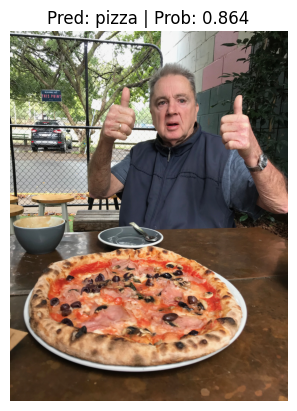

In [ ]:
# Download custom image
import requests
from going_modular.going_modular.predictions import pred_and_plot_image

# Setup custom image path
custom_image_path = Path("data/04-pizza-dad.jpeg")

# Download the image if it doesn't already exist
if not custom_image_path.is_file():
    with open(custom_image_path, "wb") as f:
        # When downloading from GitHub, need to use the "raw" file link
        request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/images/04-pizza-dad.jpeg")
        print(f"Downloading {custom_image_path}...")
        f.write(request.content)
else:
    print(f"{custom_image_path} already exists, skipping download.")

# Predict on custom image
pred_and_plot_image(model=best_model,
                    image_path=custom_image_path,
                    class_names=class_names)

**Confirmed:** For 20% data and 10 epochs, we have lower confidence of the B7 model (0.885) compared to the B2 model (0.980), but lower than the B0 model (not by much, there it's 0.864).

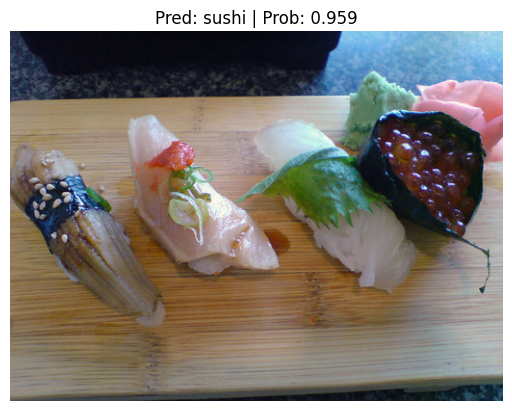

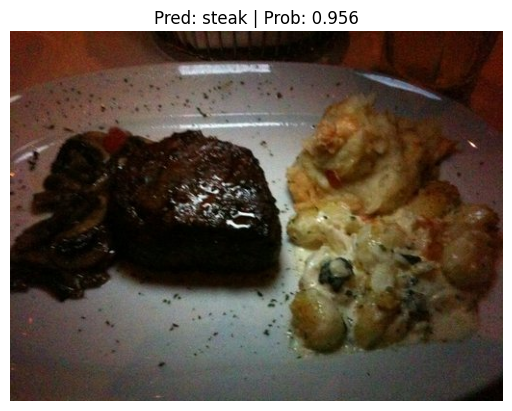

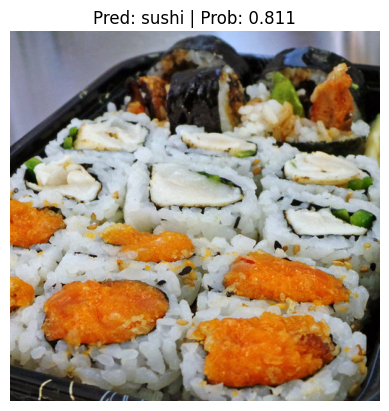

In [ ]:
# Try with random testing set images as well:

# Import function to make predictions on images and plot them
# See the function previously created in section: https://www.learnpytorch.io/06_pytorch_transfer_learning/#6-make-predictions-on-images-from-the-test-set
from going_modular.going_modular.predictions import pred_and_plot_image

# Get a random list of 3 images from 20% test set
import random
num_images_to_plot = 3
test_image_path_list = list(Path(data_20_percent_path / "test").glob("*/*.jpg")) # get all test image paths from 20% dataset
test_image_path_sample = random.sample(population=test_image_path_list,
                                       k=num_images_to_plot) # randomly select k number of images

# Iterate through random test image paths, make predictions on them and plot them
for image_path in test_image_path_sample:
    pred_and_plot_image(model=best_model,
                        image_path=image_path,
                        class_names=class_names,
                        image_size=(224, 224))


## Exercise 2. Introduce data augmentation to the list of experiments using the 20% pizza, steak, sushi training and test datasets, does this change anything?
    
* For example, you could have one training DataLoader that uses data augmentation (e.g. `train_dataloader_20_percent_aug` and `train_dataloader_20_percent_no_aug`) and then compare the results of two of the same model types training on these two DataLoaders.
* **Note:** You may need to alter the `create_dataloaders()` function to be able to take a transform for the training data and the testing data (because you don't need to perform data augmentation on the test data). See [04. PyTorch Custom Datasets section 6](https://www.learnpytorch.io/04_pytorch_custom_datasets/#6-other-forms-of-transforms-data-augmentation) for examples of using data augmentation or the script below for an example:

```python
# Note: Data augmentation transform like this should only be performed on training data
train_transform_data_aug = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.TrivialAugmentWide(),
    transforms.ToTensor(),
    normalize
])

# Create a helper function to visualize different augmented (and not augmented) images
def view_dataloader_images(dataloader, n=10):
    if n > 10:
        print(f"Having n higher than 10 will create messy plots, lowering to 10.")
        n = 10
    imgs, labels = next(iter(dataloader))
    plt.figure(figsize=(16, 8))
    for i in range(n):
        # Min max scale the image for display purposes
        targ_image = imgs[i]
        sample_min, sample_max = targ_image.min(), targ_image.max()
        sample_scaled = (targ_image - sample_min)/(sample_max - sample_min)

        # Plot images with appropriate axes information
        plt.subplot(1, 10, i+1)
        plt.imshow(sample_scaled.permute(1, 2, 0)) # resize for Matplotlib requirements
        plt.title(class_names[labels[i]])
        plt.axis(False)

# Have to update `create_dataloaders()` to handle different augmentations
import os
from torch.utils.data import DataLoader
from torchvision import datasets

NUM_WORKERS = os.cpu_count() # use maximum number of CPUs for workers to load data

# Note: this is an update version of data_setup.create_dataloaders to handle
# differnt train and test transforms.
def create_dataloaders(
    train_dir,
    test_dir,
    train_transform, # add parameter for train transform (transforms on train dataset)
    test_transform,  # add parameter for test transform (transforms on test dataset)
    batch_size=32, num_workers=NUM_WORKERS
):
    # Use ImageFolder to create dataset(s)
    train_data = datasets.ImageFolder(train_dir, transform=train_transform)
    test_data = datasets.ImageFolder(test_dir, transform=test_transform)

    # Get class names
    class_names = train_data.classes

    # Turn images into data loaders
    train_dataloader = DataLoader(
        train_data,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=True,
    )
    test_dataloader = DataLoader(
        test_data,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=True,
    )

    return train_dataloader, test_dataloader, class_names
```

# Copying the script for the updated data loader and re-doing the steps above.

In [ ]:
# Note: Data augmentation transform like this should only be performed on training data
train_transform_data_aug = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.TrivialAugmentWide(),
    transforms.ToTensor(),
    normalize
])

# Create a helper function to visualize different augmented (and not augmented) images
def view_dataloader_images(dataloader, n=10):
    if n > 10:
        print(f"Having n higher than 10 will create messy plots, lowering to 10.")
        n = 10
    imgs, labels = next(iter(dataloader))
    plt.figure(figsize=(16, 8))
    for i in range(n):
        # Min max scale the image for display purposes
        targ_image = imgs[i]
        sample_min, sample_max = targ_image.min(), targ_image.max()
        sample_scaled = (targ_image - sample_min)/(sample_max - sample_min)

        # Plot images with appropriate axes information
        plt.subplot(1, 10, i+1)
        plt.imshow(sample_scaled.permute(1, 2, 0)) # resize for Matplotlib requirements
        plt.title(class_names[labels[i]])
        plt.axis(False)

# Have to update `create_dataloaders()` to handle different augmentations
import os
from torch.utils.data import DataLoader
from torchvision import datasets

NUM_WORKERS = os.cpu_count() # use maximum number of CPUs for workers to load data

# Note: this is an update version of data_setup.create_dataloaders to handle
# differnt train and test transforms.
def create_dataloaders(
    train_dir,
    test_dir,
    train_transform, # add parameter for train transform (transforms on train dataset)
    test_transform,  # add parameter for test transform (transforms on test dataset)
    batch_size=32, num_workers=NUM_WORKERS
):
    # Use ImageFolder to create dataset(s)
    train_data = datasets.ImageFolder(train_dir, transform=train_transform)
    test_data = datasets.ImageFolder(test_dir, transform=test_transform)

    # Get class names
    class_names = train_data.classes

    # Turn images into data loaders
    train_dataloader = DataLoader(
        train_data,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=True,
    )
    test_dataloader = DataLoader(
        test_data,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=True,
    )

    return train_dataloader, test_dataloader, class_names

In [ ]:
BATCH_SIZE = 32

# Create 20% training and test DataLoaders - NON AUGMENTED DATA
train_dataloader_20_percent_no_aug, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_20_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=simple_transform,
                                                                                          batch_size=BATCH_SIZE)

# Create 20% training and test DataLoaders - AUGMENTED DATA
train_dataloader_20_percent_aug, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_20_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=train_transform_data_aug,
                                                                                          batch_size=BATCH_SIZE)

# Find the number of samples/batches per dataloader (using the same test_dataloader for both experiments)
print(f"Number of batches of size {BATCH_SIZE} in 20 percent training data without data augmentation: {len(train_dataloader_20_percent_no_aug)}")
print(f"Number of batches of size {BATCH_SIZE} in 20 percent training data with data augmentation:: {len(train_dataloader_20_percent_aug)}")
print(f"Number of batches of size {BATCH_SIZE} in testing data: {len(test_dataloader)} (all experiments will use the same test set)")
print(f"Number of classes: {len(class_names)}, class names: {class_names}")

Number of batches of size 32 in 20 percent training data without data augmentation: 15
Number of batches of size 32 in 20 percent training data with data augmentation:: 15
Number of batches of size 32 in testing data: 3 (all experiments will use the same test set)
Number of classes: 3, class names: ['pizza', 'steak', 'sushi']


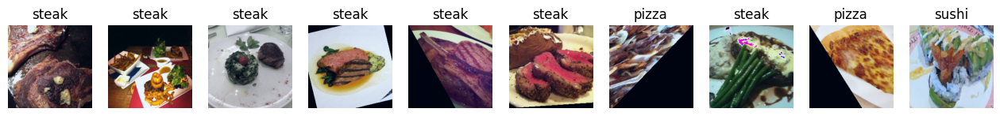

In [ ]:
# Check out samples with data augmentation
view_dataloader_images(train_dataloader_20_percent_aug)

In [ ]:
# 1. Create epochs list
num_epochs = [5, 10]

# 2. Create models list (need to create a new model for each experiment)
models = ["effnetb0", "effnetb2", "effnetb7"]
# 3. Create dataloaders dictionary for various dataloaders
train_dataloaders = {"data_20_percent_no_aug": train_dataloader_20_percent_no_aug,
                     "data_20_percent_aug": train_dataloader_20_percent_aug}

In [ ]:
%%time
from going_modular.going_modular.utils import save_model

# 1. Set the random seeds
set_seeds(seed=42)

# 2. Keep track of experiment numbers
experiment_number = 0

# 3. Loop through each DataLoader
for dataloader_name, train_dataloader in train_dataloaders.items():

    # 4. Loop through each number of epochs
    for epochs in num_epochs:

        # 5. Loop through each model name and create a new model based on the name
        for model_name in models:

            # 6. Create information print outs
            experiment_number += 1
            print(f"[INFO] Experiment number: {experiment_number}")
            print(f"[INFO] Model: {model_name}")
            print(f"[INFO] DataLoader: {dataloader_name}")
            print(f"[INFO] Number of epochs: {epochs}")

            # 7. Select the model
            if model_name == "effnetb0":
                model = create_effnetb0() # creates a new model each time (important because we want each experiment to start from scratch)
            elif model_name == "effnetb2":
                model = create_effnetb2() # creates a new model each time (important because we want each experiment to start from scratch)
            else:
                model = create_effnetb7() # creates a new model each time (important because we want each experiment to start from scratch)

            # 8. Create a new loss and optimizer for every model
            loss_fn = nn.CrossEntropyLoss()
            optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)

            # 9. Train target model with target dataloaders and track experiments
            train(model=model,
                  train_dataloader=train_dataloader,
                  test_dataloader=test_dataloader,
                  optimizer=optimizer,
                  loss_fn=loss_fn,
                  epochs=epochs,
                  device=device,
                  writer=create_writer(experiment_name=dataloader_name,
                                       model_name=model_name,
                                       extra=f"{epochs}_epochs"))

            # 10. Save the model to file so we can get back the best model
            save_filepath = f"07_{model_name}_{dataloader_name}_{epochs}_epochs.pth"
            save_model(model=model,
                       target_dir="models",
                       model_name=save_filepath)
            print("-"*50 + "\n")

[INFO] Experiment number: 1
[INFO] Model: effnetb0
[INFO] DataLoader: data_20_percent_no_aug
[INFO] Number of epochs: 5
[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_no_aug/effnetb0/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.7143 | test_acc: 0.8040
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.7100 | test_acc: 0.7841
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.6469 | test_acc: 0.7642
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.5817 | test_acc: 0.8570
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.5367 | test_acc: 0.8665
[INFO] Saving model to: models/07_effnetb0_data_20_percent_no_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 2
[INFO] Model: effnetb2
[INFO] DataLoader: data_20_percent_no_aug
[INFO] Number of epochs: 5
[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_no_aug/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9750 | train_acc: 0.5625 | test_loss: 0.8000 | test_acc: 0.7841
Epoch: 2 | train_loss: 0.7173 | train_acc: 0.7896 | test_loss: 0.7363 | test_acc: 0.8352
Epoch: 3 | train_loss: 0.5869 | train_acc: 0.8500 | test_loss: 0.6508 | test_acc: 0.8655
Epoch: 4 | train_loss: 0.5314 | train_acc: 0.8354 | test_loss: 0.6304 | test_acc: 0.8456
Epoch: 5 | train_loss: 0.4264 | train_acc: 0.8979 | test_loss: 0.5190 | test_acc: 0.8864
[INFO] Saving model to: models/07_effnetb2_data_20_percent_no_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 3
[INFO] Model: effnetb7
[INFO] DataLoader: data_20_percent_no_aug
[INFO] Number of epochs: 5
[INFO] Created new effnetb7 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_no_aug/effnetb7/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9598 | train_acc: 0.6562 | test_loss: 0.8649 | test_acc: 0.7642
Epoch: 2 | train_loss: 0.6999 | train_acc: 0.8562 | test_loss: 0.6770 | test_acc: 0.7955
Epoch: 3 | train_loss: 0.5718 | train_acc: 0.8896 | test_loss: 0.5976 | test_acc: 0.8267
Epoch: 4 | train_loss: 0.4909 | train_acc: 0.8625 | test_loss: 0.5402 | test_acc: 0.7860
Epoch: 5 | train_loss: 0.4472 | train_acc: 0.9083 | test_loss: 0.4887 | test_acc: 0.8466
[INFO] Saving model to: models/07_effnetb7_data_20_percent_no_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 4
[INFO] Model: effnetb0
[INFO] DataLoader: data_20_percent_no_aug
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_no_aug/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.7143 | test_acc: 0.8040
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.7100 | test_acc: 0.7841
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.6469 | test_acc: 0.7642
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.5817 | test_acc: 0.8570
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.5367 | test_acc: 0.8665
Epoch: 6 | train_loss: 0.3705 | train_acc: 0.8854 | test_loss: 0.7207 | test_acc: 0.8134
Epoch: 7 | train_loss: 0.3551 | train_acc: 0.9250 | test_loss: 0.4629 | test_acc: 0.8248
Epoch: 8 | train_loss: 0.3745 | train_acc: 0.8938 | test_loss: 0.4314 | test_acc: 0.8362
Epoch: 9 | train_loss: 0.2972 | train_acc: 0.9396 | test_loss: 0.4746 | test_acc: 0.8153
Epoch: 10 | train_loss: 0.3620 | train_acc: 0.8479 | test_loss: 0.4922 | test_acc: 0.8258
[INFO] Saving model to: models/07_effnetb0_data_20_percent_no_aug_10_epochs.pth
-----------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9750 | train_acc: 0.5625 | test_loss: 0.8000 | test_acc: 0.7841
Epoch: 2 | train_loss: 0.7173 | train_acc: 0.7896 | test_loss: 0.7363 | test_acc: 0.8352
Epoch: 3 | train_loss: 0.5869 | train_acc: 0.8500 | test_loss: 0.6508 | test_acc: 0.8655
Epoch: 4 | train_loss: 0.5314 | train_acc: 0.8354 | test_loss: 0.6304 | test_acc: 0.8456
Epoch: 5 | train_loss: 0.4264 | train_acc: 0.8979 | test_loss: 0.5190 | test_acc: 0.8864
Epoch: 6 | train_loss: 0.3750 | train_acc: 0.9146 | test_loss: 0.6008 | test_acc: 0.7841
Epoch: 7 | train_loss: 0.3398 | train_acc: 0.9271 | test_loss: 0.4108 | test_acc: 0.9280
Epoch: 8 | train_loss: 0.3717 | train_acc: 0.8958 | test_loss: 0.5746 | test_acc: 0.7547
Epoch: 9 | train_loss: 0.3204 | train_acc: 0.9208 | test_loss: 0.5369 | test_acc: 0.7964
Epoch: 10 | train_loss: 0.3380 | train_acc: 0.8938 | test_loss: 0.4225 | test_acc: 0.9271
[INFO] Saving model to: models/07_effnetb2_data_20_percent_no_aug_10_epochs.pth
-----------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9598 | train_acc: 0.6562 | test_loss: 0.8649 | test_acc: 0.7642
Epoch: 2 | train_loss: 0.6999 | train_acc: 0.8562 | test_loss: 0.6770 | test_acc: 0.7955
Epoch: 3 | train_loss: 0.5718 | train_acc: 0.8896 | test_loss: 0.5976 | test_acc: 0.8267
Epoch: 4 | train_loss: 0.4909 | train_acc: 0.8625 | test_loss: 0.5402 | test_acc: 0.7860
Epoch: 5 | train_loss: 0.4472 | train_acc: 0.9083 | test_loss: 0.4887 | test_acc: 0.8466
Epoch: 6 | train_loss: 0.4169 | train_acc: 0.9104 | test_loss: 0.4932 | test_acc: 0.8049
Epoch: 7 | train_loss: 0.3695 | train_acc: 0.9167 | test_loss: 0.4611 | test_acc: 0.7955
Epoch: 8 | train_loss: 0.3506 | train_acc: 0.9042 | test_loss: 0.4968 | test_acc: 0.8362
Epoch: 9 | train_loss: 0.3181 | train_acc: 0.9313 | test_loss: 0.4730 | test_acc: 0.7443
Epoch: 10 | train_loss: 0.3162 | train_acc: 0.9542 | test_loss: 0.4961 | test_acc: 0.7955
[INFO] Saving model to: models/07_effnetb7_data_20_percent_no_aug_10_epochs.pth
-----------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9665 | train_acc: 0.5708 | test_loss: 0.7149 | test_acc: 0.8239
Epoch: 2 | train_loss: 0.7178 | train_acc: 0.8229 | test_loss: 0.7005 | test_acc: 0.7945
Epoch: 3 | train_loss: 0.6244 | train_acc: 0.8146 | test_loss: 0.5543 | test_acc: 0.8456
Epoch: 4 | train_loss: 0.5532 | train_acc: 0.8229 | test_loss: 0.5016 | test_acc: 0.8778
Epoch: 5 | train_loss: 0.5771 | train_acc: 0.7750 | test_loss: 0.4583 | test_acc: 0.9176
[INFO] Saving model to: models/07_effnetb0_data_20_percent_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 8
[INFO] Model: effnetb2
[INFO] DataLoader: data_20_percent_aug
[INFO] Number of epochs: 5
[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_aug/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9895 | train_acc: 0.4958 | test_loss: 0.7981 | test_acc: 0.7945
Epoch: 2 | train_loss: 0.7596 | train_acc: 0.7646 | test_loss: 0.7140 | test_acc: 0.8456
Epoch: 3 | train_loss: 0.6607 | train_acc: 0.7667 | test_loss: 0.6188 | test_acc: 0.8873
Epoch: 4 | train_loss: 0.5614 | train_acc: 0.8167 | test_loss: 0.5947 | test_acc: 0.8570
Epoch: 5 | train_loss: 0.4998 | train_acc: 0.8542 | test_loss: 0.4613 | test_acc: 0.9176
[INFO] Saving model to: models/07_effnetb2_data_20_percent_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 9
[INFO] Model: effnetb7
[INFO] DataLoader: data_20_percent_aug
[INFO] Number of epochs: 5
[INFO] Created new effnetb7 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_aug/effnetb7/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9793 | train_acc: 0.6396 | test_loss: 0.8951 | test_acc: 0.7538
Epoch: 2 | train_loss: 0.7566 | train_acc: 0.8000 | test_loss: 0.7152 | test_acc: 0.7955
Epoch: 3 | train_loss: 0.6424 | train_acc: 0.8146 | test_loss: 0.6432 | test_acc: 0.7860
Epoch: 4 | train_loss: 0.5608 | train_acc: 0.8417 | test_loss: 0.5761 | test_acc: 0.7756
Epoch: 5 | train_loss: 0.5445 | train_acc: 0.8521 | test_loss: 0.5204 | test_acc: 0.8570
[INFO] Saving model to: models/07_effnetb7_data_20_percent_aug_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 10
[INFO] Model: effnetb0
[INFO] DataLoader: data_20_percent_aug
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model.
[INFO] Created SummaryWriter, saving to: runs/2024-06-10/data_20_percent_aug/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9665 | train_acc: 0.5708 | test_loss: 0.7149 | test_acc: 0.8239
Epoch: 2 | train_loss: 0.7178 | train_acc: 0.8229 | test_loss: 0.7005 | test_acc: 0.7945
Epoch: 3 | train_loss: 0.6244 | train_acc: 0.8146 | test_loss: 0.5543 | test_acc: 0.8456
Epoch: 4 | train_loss: 0.5532 | train_acc: 0.8229 | test_loss: 0.5016 | test_acc: 0.8778
Epoch: 5 | train_loss: 0.5771 | train_acc: 0.7750 | test_loss: 0.4583 | test_acc: 0.9176
Epoch: 6 | train_loss: 0.4564 | train_acc: 0.8750 | test_loss: 0.4452 | test_acc: 0.8456
Epoch: 7 | train_loss: 0.4383 | train_acc: 0.8917 | test_loss: 0.3778 | test_acc: 0.9072
Epoch: 8 | train_loss: 0.4411 | train_acc: 0.8562 | test_loss: 0.3753 | test_acc: 0.8873
Epoch: 9 | train_loss: 0.3868 | train_acc: 0.8812 | test_loss: 0.3706 | test_acc: 0.8769
Epoch: 10 | train_loss: 0.4524 | train_acc: 0.8271 | test_loss: 0.3798 | test_acc: 0.8873
[INFO] Saving model to: models/07_effnetb0_data_20_percent_aug_10_epochs.pth
--------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9895 | train_acc: 0.4958 | test_loss: 0.7981 | test_acc: 0.7945
Epoch: 2 | train_loss: 0.7596 | train_acc: 0.7646 | test_loss: 0.7140 | test_acc: 0.8456
Epoch: 3 | train_loss: 0.6607 | train_acc: 0.7667 | test_loss: 0.6188 | test_acc: 0.8873
Epoch: 4 | train_loss: 0.5614 | train_acc: 0.8167 | test_loss: 0.5947 | test_acc: 0.8570
Epoch: 5 | train_loss: 0.4998 | train_acc: 0.8542 | test_loss: 0.4613 | test_acc: 0.9176
Epoch: 6 | train_loss: 0.4338 | train_acc: 0.8854 | test_loss: 0.5255 | test_acc: 0.8873
Epoch: 7 | train_loss: 0.4350 | train_acc: 0.8667 | test_loss: 0.4570 | test_acc: 0.9176
Epoch: 8 | train_loss: 0.4263 | train_acc: 0.8729 | test_loss: 0.5069 | test_acc: 0.8665
Epoch: 9 | train_loss: 0.3909 | train_acc: 0.9042 | test_loss: 0.4892 | test_acc: 0.8674
Epoch: 10 | train_loss: 0.3885 | train_acc: 0.8688 | test_loss: 0.3916 | test_acc: 0.9375
[INFO] Saving model to: models/07_effnetb2_data_20_percent_aug_10_epochs.pth
--------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9793 | train_acc: 0.6396 | test_loss: 0.8951 | test_acc: 0.7538
Epoch: 2 | train_loss: 0.7566 | train_acc: 0.8000 | test_loss: 0.7152 | test_acc: 0.7955
Epoch: 3 | train_loss: 0.6424 | train_acc: 0.8146 | test_loss: 0.6432 | test_acc: 0.7860
Epoch: 4 | train_loss: 0.5608 | train_acc: 0.8417 | test_loss: 0.5761 | test_acc: 0.7756
Epoch: 5 | train_loss: 0.5445 | train_acc: 0.8521 | test_loss: 0.5204 | test_acc: 0.8570
Epoch: 6 | train_loss: 0.5314 | train_acc: 0.8479 | test_loss: 0.5130 | test_acc: 0.7955
Epoch: 7 | train_loss: 0.4804 | train_acc: 0.8354 | test_loss: 0.5107 | test_acc: 0.7955
Epoch: 8 | train_loss: 0.4419 | train_acc: 0.8625 | test_loss: 0.4732 | test_acc: 0.8466
Epoch: 9 | train_loss: 0.4158 | train_acc: 0.8833 | test_loss: 0.5018 | test_acc: 0.7652
Epoch: 10 | train_loss: 0.4093 | train_acc: 0.8917 | test_loss: 0.4769 | test_acc: 0.8059
[INFO] Saving model to: models/07_effnetb7_data_20_percent_aug_10_epochs.pth
--------------------------------

In [ ]:
# Viewing TensorBoard in Jupyter and Google Colab Notebooks (uncomment to view full TensorBoard instance)
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 11289), started 0:47:09 ago. (Use '!kill 11289' to kill it.)

<IPython.core.display.Javascript object>

I can't spot any massive difference compared to before. Augmentation seems to have raised the general performance a bit, maybe, of all models that used it,
but not really in comparison to the non-augmented models. At least I can't spot any general trend. Still, let's assume the best model is a data-augmented one to compare the performance on the usual image, with the above.

Load best model and predict on custom image. Try some models out.

Note, before; with no augmentation, we had:
- P(B7) = 0.885
- P(B2) = 0.980
- P(B0) = 0.864

In [ ]:
# Setup the best model filepath
best_model_path = "models/07_effnetb0_data_20_percent_aug_10_epochs.pth"

# Instantiate a new instance of EffNetB7 (to load the saved state_dict() to)
best_model = create_effnetb0()

# Load the saved best model state_dict()
best_model.load_state_dict(torch.load(best_model_path))

[INFO] Created new effnetb0 model.


<All keys matched successfully>

data/04-pizza-dad.jpeg already exists, skipping download.


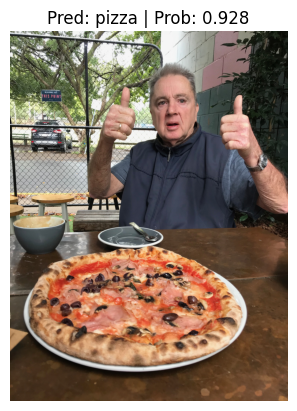

In [ ]:
# Download custom image
import requests
from going_modular.going_modular.predictions import pred_and_plot_image

# Setup custom image path
custom_image_path = Path("data/04-pizza-dad.jpeg")

# Download the image if it doesn't already exist
if not custom_image_path.is_file():
    with open(custom_image_path, "wb") as f:
        # When downloading from GitHub, need to use the "raw" file link
        request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/images/04-pizza-dad.jpeg")
        print(f"Downloading {custom_image_path}...")
        f.write(request.content)
else:
    print(f"{custom_image_path} already exists, skipping download.")

# Predict on custom image
pred_and_plot_image(model=best_model,
                    image_path=custom_image_path,
                    class_names=class_names)

Now, with data augmentation, we get:
- P(B7) = 0.859
- P(B2) = 0.972
- P(B0) = 0.928

We observe a noticeable upgrade in the performance of B0 compared to the no_aug version. In fact, it seems to perform even better than the B7 model, which is surprising. Pretty much the same to lower performance for the other two models though. Does this make sense?

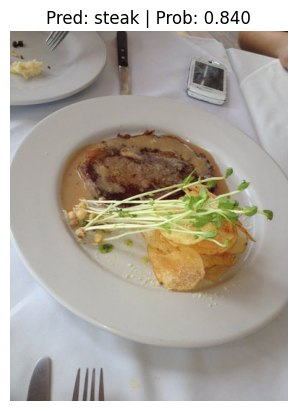

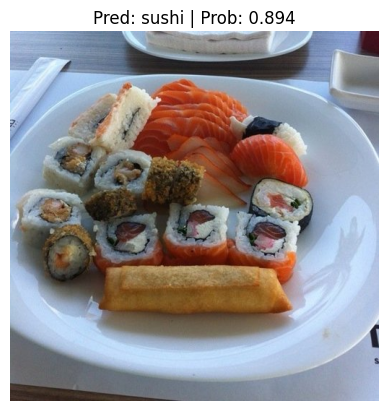

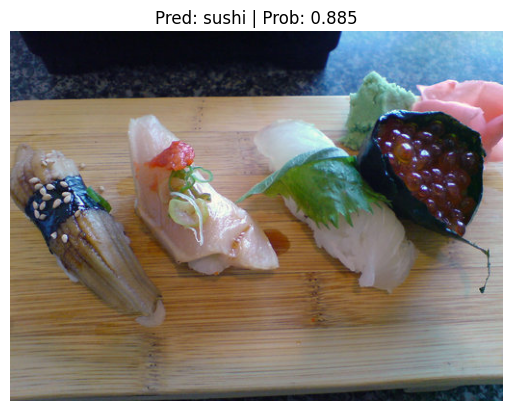

In [ ]:
# Try with random testing set images as well:

# Import function to make predictions on images and plot them
# See the function previously created in section: https://www.learnpytorch.io/06_pytorch_transfer_learning/#6-make-predictions-on-images-from-the-test-set
from going_modular.going_modular.predictions import pred_and_plot_image

# Get a random list of 3 images from 20% test set
import random
num_images_to_plot = 3
test_image_path_list = list(Path(data_20_percent_path / "test").glob("*/*.jpg")) # get all test image paths from 20% dataset
test_image_path_sample = random.sample(population=test_image_path_list,
                                       k=num_images_to_plot) # randomly select k number of images

# Iterate through random test image paths, make predictions on them and plot them
for image_path in test_image_path_sample:
    pred_and_plot_image(model=best_model,
                        image_path=image_path,
                        class_names=class_names,
                        image_size=(224, 224))


## Exercise 3. Scale up the dataset to turn FoodVision Mini into FoodVision Big using the entire [Food101 dataset from `torchvision.models`](https://pytorch.org/vision/stable/generated/torchvision.datasets.Food101.html#torchvision.datasets.Food101)
    
* You could take the best performing model from your various experiments or even the EffNetB2 feature extractor we created in this notebook and see how it goes fitting for 5 epochs on all of Food101.
* If you try more than one model, it would be good to have the model's results tracked.
* If you load the Food101 dataset from `torchvision.models`, you'll have to create PyTorch DataLoaders to use it in training.
* **Note:** Due to the larger amount of data in Food101 compared to our pizza, steak, sushi dataset, this model will take longer to train.

First, I will train my EffNetB2 WITHOUT data augmentation on the full FoodVisionMini dataset, for 5 epochs. I could also try the other two too.

In [ ]:
# Get Food101 Dataset
import torchvision
from torchvision import transforms

# Create a transform to normalize data distribution to be inline with ImageNet
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], # values per colour channel [red, green, blue]
                                 std=[0.229, 0.224, 0.225])

# Create a transform pipeline
simple_transform = transforms.Compose([
                                       transforms.Resize((224, 224)),
                                       transforms.ToTensor(), # get image values between 0 & 1
                                       normalize
])

# Download and transform Food101 data (note: this may take ~5 minutes in Google Colab)
train_data = torchvision.datasets.Food101(root="data",
                                          split="train",
                                          transform=simple_transform,
                                          download=True)

test_data = torchvision.datasets.Food101(root="data",
                                        split="test",
                                        transform=simple_transform,
                                        download=True)

In [ ]:
# Check sample numbers
len(train_data), len(test_data)

(75750, 25250)

In [ ]:
# Create DataLoaders
import os
BATCH_SIZE = 512 # use a big batch size to get through all the images (100,000+ in Food101)

train_dataloader_big = torch.utils.data.DataLoader(train_data,
                                                   shuffle=True,
                                                   batch_size=BATCH_SIZE,
                                                   num_workers=os.cpu_count(),
                                                   pin_memory=True) # avoid copies of the data into and out of memory, where possible (for speed ups)

test_dataloader_big = torch.utils.data.DataLoader(test_data,
                                                  shuffle=False,
                                                  batch_size=BATCH_SIZE,
                                                  num_workers=os.cpu_count(),
                                                  pin_memory=True)

In [ ]:
import torchvision
from torchinfo import summary

# 1. Get the base model with pretrained weights and send to target device
foodvision_big_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
foodvision_big_model = torchvision.models.efficientnet_b2(weights=foodvision_big_weights).to(device)

# 2. Get a summary
summary(model=foodvision_big_model,
         input_size=(512, 3, 224, 224), # make sure this is "input_size", not "input_shape"#
         # col_names=["input_size"], # uncomment for smaller output
         col_names=["input_size", "output_size", "num_params", "trainable"],
         col_width=20,
         row_settings=["var_names"]
)

# 3. Get the number of in_features of the EfficientNetB2 classifier layer
print(f"Number of in_features to final layer of FoodVisionBig Model: {len(foodvision_big_model.classifier.state_dict()['1.weight'][0])}")

Number of in_features to final layer of FoodVisionBig Model: 1408


In [ ]:
import torchvision
from torch import nn

# Create an EffNetB2 feature extractor
def create_foodvision_big_model():
    # 1. Get the base model with pretrained weights and send to target device
    foodvision_big_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    foodvision_big_model = torchvision.models.efficientnet_b2(weights=foodvision_big_weights).to(device)

    # 2. Freeze the base model layers
    for param in foodvision_big_model.features.parameters():
        param.requires_grad = False

    # 3. Set the seeds
    set_seeds()

    # 4. Change the classifier head
    foodvision_big_model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=1408, out_features=101) # number of classes in FoodVision dataset
    ).to(device)

    # 5. Give the model a name
    foodvision_big_model.name = "foodvision_big_model"
    print(f"[INFO] Created new {foodvision_big_model.name} model.")
    return foodvision_big_model

In [ ]:
# Create big model
foodvision_big_model = create_foodvision_big_model()

[INFO] Created new foodvision_big_model model.


Train the model. To avoid OutOfMemoryError: "CUDA out of memory. Tried to allocate 4.59 GiB. GPU." -->
https://stackoverflow.com/questions/59129812/how-to-avoid-cuda-out-of-memory-in-pytorch

In [ ]:
import torch
torch.cuda.empty_cache()

In [ ]:
epochs = 5 # for some reason it needs me to reassignt this

Received this warning. Seems to run anyway.

"/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called.
os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()"

In [ ]:
foodvision_big_results = train(model=foodvision_big_model,
                               train_dataloader=train_dataloader_big,
                               test_dataloader=test_dataloader_big,
                               optimizer=torch.optim.Adam(params=foodvision_big_model.parameters(), lr=0.001),
                               loss_fn=torch.nn.CrossEntropyLoss(),
                               epochs=5,
                               device=device,
                               writer=create_writer(experiment_name="food101_all_data",
                                                    model_name="foodvision_big",
                                                    extra=f"{epochs}_epochs"))

[INFO] Created SummaryWriter, saving to: runs/2024-06-10/food101_all_data/foodvision_big/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 3.3583 | train_acc: 0.3307 | test_loss: 2.4215 | test_acc: 0.4946
Epoch: 2 | train_loss: 2.4153 | train_acc: 0.4592 | test_loss: 2.0321 | test_acc: 0.5298
Epoch: 3 | train_loss: 2.1760 | train_acc: 0.4892 | test_loss: 1.8914 | test_acc: 0.5501
Epoch: 4 | train_loss: 2.0609 | train_acc: 0.5093 | test_loss: 1.8120 | test_acc: 0.5611
Epoch: 5 | train_loss: 1.9868 | train_acc: 0.5195 | test_loss: 1.7718 | test_acc: 0.5662


Not really good performance, but tracks with the solutions notebook.